In [4]:
import pandas as pd
from analysis import *
import numpy as np
import matplotlib.pyplot as plt
from preprocessing import *

# Preprocessing

In [8]:
#preprocess('data_2021_06_10/converted_xe_2tdc_horiz_7.txt','tdc_horiz_7.txt','cent_horiz_7.csv')

In [9]:
#preprocess('data_2021_06_10/converted_xe_2tdc_vert_8.txt','tdc_vert_8.txt','cent_vert_8.csv')

In [10]:
#preprocess('data_2021_06_10/converted_xe_2tdc_vert_4.txt','tdc_vert_4.txt','cent_vert_4.csv')

In [11]:
#preprocess('data_2021_06_10/converted_xe_2tdc_45deg_11.txt','tdc_45deg_11.txt','cent_45deg_11.csv')

In [12]:
#preprocess('data_2021_06_10/converted_xe_2tdc_30deg_12.txt','tdc_30deg_12.txt','cent_30deg_12.csv')

In [13]:
#preprocess('data_2021_06_10/converted_xe_2tdc_horiz_3.txt','tdc_horiz_3.txt','cent_horiz_3.csv')

In [14]:
#tdc_stripper('data_2021_06_10/converted_xe_2tdc_vert_5.txt','tdc_vert_5.txt')

In [15]:
#tdc_stripper('data_2021_06_10/converted_xe_2tdc_horiz_6.txt','tdc_horiz_6.txt')

In [16]:
#preprocess('data_2021_06_10/converted_xe_2tdc_vert_5.txt','tdc_vert_5.txt','cent_vert_5.csv')

In [17]:
#preprocess('data_2021_06_10/converted_xe_2tdc_horiz_6.txt','tdc_horiz_6.txt','cent_horiz_6.csv')

# Load all Datasets

In [15]:
slow_v = pd.read_csv('cent_vert_8.csv')
slow_v.delta_t = slow_v.delta_t*1e9
slow_h = pd.read_csv('cent_horiz_7.csv')
slow_h.delta_t = slow_h.delta_t*1e9
med_v = pd.read_csv('cent_vert_5.csv')
med_v.delta_t = med_v.delta_t*1e9
med_h = pd.read_csv('cent_horiz_6.csv')
med_h.delta_t = med_h.delta_t*1e9
fast_v = pd.read_csv('cent_vert_4.csv')
fast_v.delta_t = fast_v.delta_t*1e9
fast_h = pd.read_csv('cent_horiz_3.csv')
fast_h.delta_t = fast_h.delta_t*1e9
circular = pd.read_csv('cent_45deg_11.csv')
circular.delta_t = circular.delta_t*1e9
ellip = pd.read_csv('cent_30deg_12.csv')
ellip.delta_t = ellip.delta_t*1e9

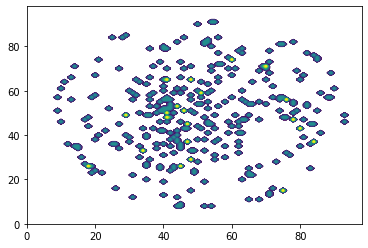

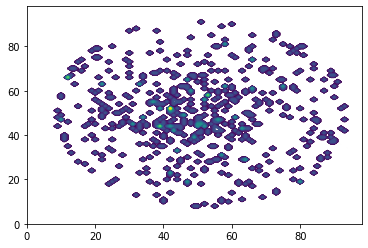

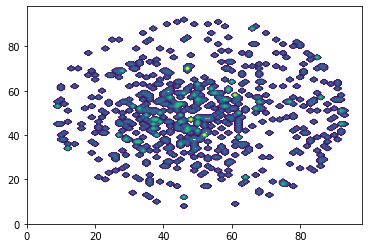

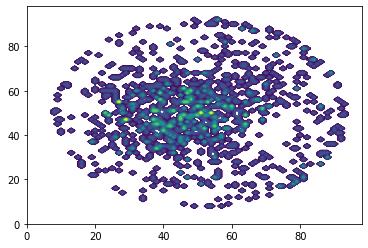

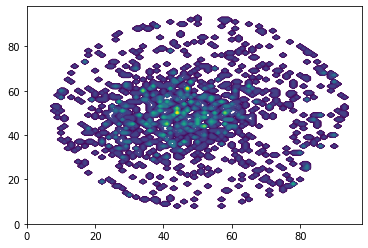

...

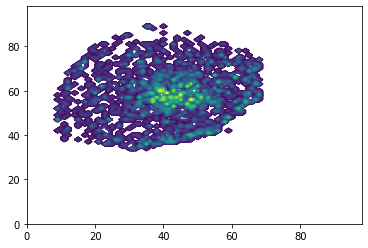

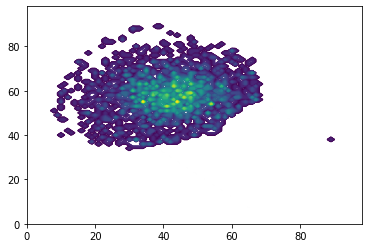

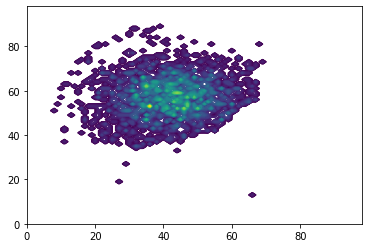

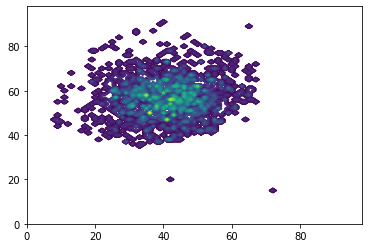

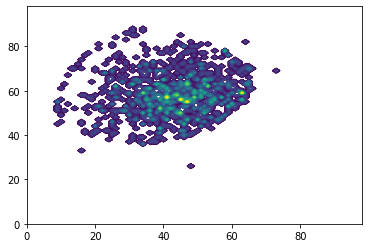

In [67]:
for cutoff in np.linspace(4732,4740,31):
    tmp= slow_v[(slow_v['delta_t'] >= cutoff) & (slow_v['delta_t'] <= cutoff+0.25)]
    plt.contour(to_plot_2dhist(tmp,'x','y'),levels=200)
    plt.show()


In [151]:
tmp= slow_v[(slow_v['delta_t'] >= 4732) & (slow_v['delta_t'] <= 4740)]

In [154]:
tmp3=tmp[(tmp['x']<255*0.75) & tmp['y'] <255*0.75]

In [2]:
from skimage import io

In [32]:
vol = np.histogramdd(np.array(slow_v.drop('batch',axis=1)),bins=(np.linspace(0,255,100),
                                           np.linspace(0,255,100),
                                           np.linspace(4732,4740,31,endpoint=False)))[0]
volume = vol.T
r, c = volume[0].shape

# Define frames
import plotly.graph_objects as go
nb_frames = vol.shape[-1]

fig = go.Figure(frames=[go.Frame(data=go.Surface(
    z=(6.7 - k * 0.1) * np.ones((r, c)),
    surfacecolor=np.flipud(volume[nb_frames-1 - k]),
    cmin=0, cmax=200
    ),
    name=str(k) # you need to name the frame for the animation to behave properly
    )
    for k in range(nb_frames)])

# Add data to be displayed before animation starts
fig.add_trace(go.Surface(
    z=6.7 * np.ones((r, c)),
    cmin=0, cmax=200,
    colorbar=dict(thickness=20, ticklen=4)
    ))

In [279]:
tmp=np.histogramdd(np.array(slow_v.drop('batch',axis=1)),bins=(np.linspace(0,255,100),
                                           np.linspace(0,255,100),
                                           np.linspace(4732,4740,31,endpoint=False)))[0]
xs,ys,zs=ticks

In [287]:
xs[:-1]

array([  0.        ,   2.57575758,   5.15151515,   7.72727273,
        10.3030303 ,  12.87878788,  15.45454545,  18.03030303,
        20.60606061,  23.18181818,  25.75757576,  28.33333333,
        30.90909091,  33.48484848,  36.06060606,  38.63636364,
        41.21212121,  43.78787879,  46.36363636,  48.93939394,
        51.51515152,  54.09090909,  56.66666667,  59.24242424,
        61.81818182,  64.39393939,  66.96969697,  69.54545455,
        72.12121212,  74.6969697 ,  77.27272727,  79.84848485,
        82.42424242,  85.        ,  87.57575758,  90.15151515,
        92.72727273,  95.3030303 ,  97.87878788, 100.45454545,
       103.03030303, 105.60606061, 108.18181818, 110.75757576,
       113.33333333, 115.90909091, 118.48484848, 121.06060606,
       123.63636364, 126.21212121, 128.78787879, 131.36363636,
       133.93939394, 136.51515152, 139.09090909, 141.66666667,
       144.24242424, 146.81818182, 149.39393939, 151.96969697,
       154.54545455, 157.12121212, 159.6969697 , 162.27

In [69]:
X, Y, Z = np.mgrid[0:255:100j, 0:255:100j, 4732:4740:32j]
values=np.sin(X*Y*Z)

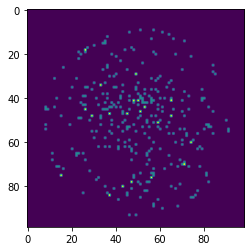

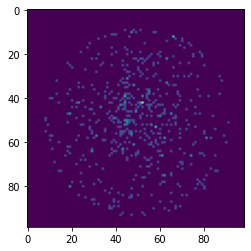

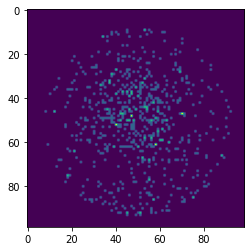

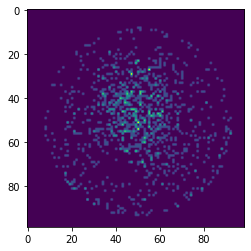

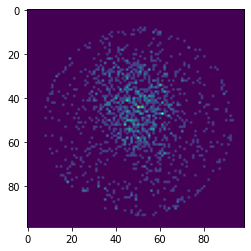

...

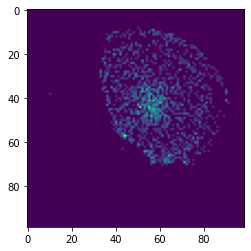

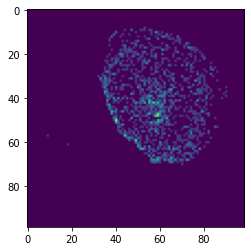

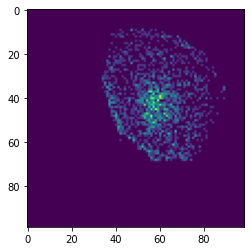

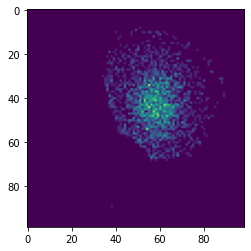

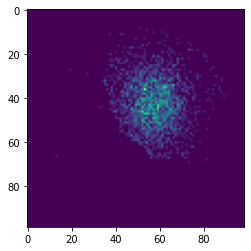

In [81]:
for i in range(30):
    plt.imshow(tmp[:,:,i],)
    plt.show()

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

<IPython.core.display.Javascript object>


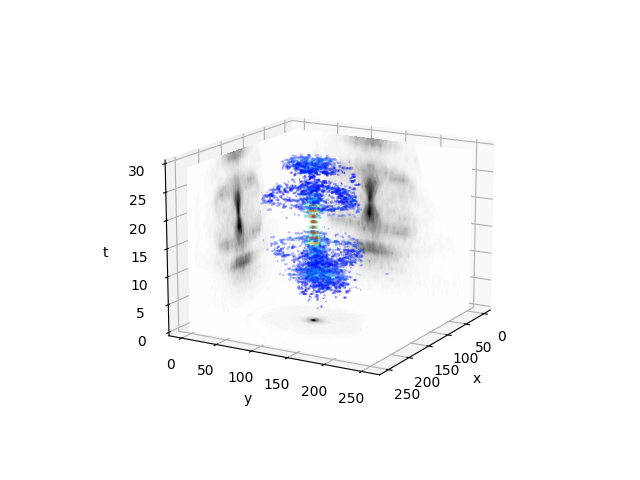

<ipython-input-372-ed41a3a92fa9>:18: UserWarning:

No contour levels were found within the data range.



In [372]:
tmp=np.histogramdd(np.array(slow_v.drop('batch',axis=1)),bins=(np.linspace(0,255,100),
                                           np.linspace(0,255,100),
                                           np.linspace(4732,4740,31,endpoint=False)))[0]
xx, yy = np.meshgrid(np.linspace(0,255,99,endpoint=False),
                     np.linspace(0,255,99,endpoint=False))
                     

aa , bb =np.meshgrid(np.linspace(0,255,99,endpoint=False),
                     np.linspace(0,30,30,endpoint=False))
    
fig = plt.figure()

ax = plt.axes(projection ='3d')

ax.set_zlim3d(0,30)
for i in range(30):
    data=np.ma.masked_where(tmp[:,:,i] <=1, tmp[:,:,i])
    ax.contour(xx, yy, data, zdir='z',offset=i,alpha = .3,vmin=0,vmax=20,cmap='jet')

ty_plane = to_plot_2dhist(slow_v,'x','delta_t',
                              bint=np.linspace(4732,4740,31,endpoint=False))
#ty_plane = np.ma.masked_where(ty_plane<=10,ty_plane)

tx_plane = to_plot_2dhist(slow_v,'y','delta_t',
                              bint=np.linspace(4732,4740,31,endpoint=False))
xy_plane =  to_plot_2dhist(slow_v,'x','y',
                              bint=np.linspace(4732,4740,31,endpoint=False))

#tx_plane = np.ma.masked_where(tx_plane<=10,tx_plane)

ax.contourf(aa,tmp.sum(axis=0).T,
            bb,40,offset=0,zdir='y',cmap='Greys')
ax.contourf(tmp.sum(axis=1).T,aa,
            bb,40,offset=0,zdir='x',cmap='Greys')

ax.contourf(xx,yy,tmp.sum(axis=2),40,offset=0,zdir='z',cmap='Greys')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('t')

#for cutoff in np.linspace(4732,4740,31):
#    tmp= slow_v[(slow_v['delta_t'] >= cutoff) & (slow_v['delta_t'] <= cutoff+0.25)]
#    data = to_plot_2dhist(tmp,'x','y')
#    ax.contour(xx,yy,data ,zdir='z',offset=cutoff)
ax.view_init(azim=30,elev=15)
plt.savefig('3d-vert.pdf')
plt.show()

<IPython.core.display.Javascript object>


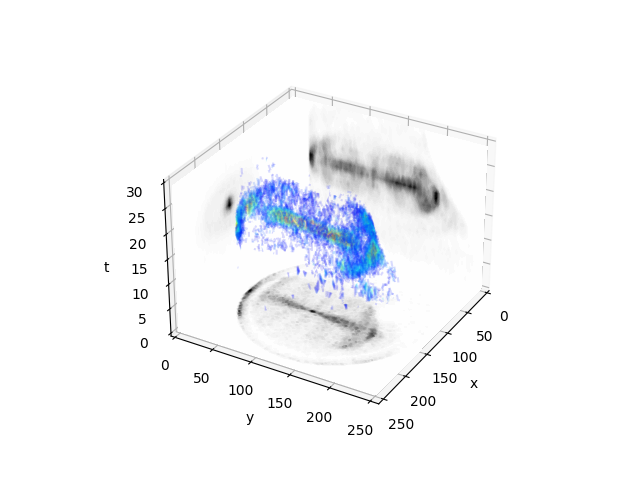

/home/gonenc/.local/lib/python3.8/site-packages/matplotlib/contour.py:1494: UserWarning:


/home/gonenc/.local/lib/python3.8/site-packages/matplotlib/contour.py:1495: UserWarning:


<ipython-input-371-61384bbfb3dd>:22: UserWarning:

No contour levels were found within the data range.



In [371]:
tmp=np.histogramdd(np.array(slow_h.drop('batch',axis=1)),bins=(np.linspace(0,255,100),
                                           np.linspace(0,255,100),
                                           np.linspace(4732,4740,31,endpoint=False)))[0]
xx, yy = np.meshgrid(np.linspace(0,255,99,endpoint=False),
                     np.linspace(0,255,99,endpoint=False))
                     

aa , bb =np.meshgrid(np.linspace(0,255,99,endpoint=False),
                     np.linspace(0,30,30,endpoint=False))
    
fig = plt.figure()

ax = plt.axes(projection ='3d')
ax.set_xlim3d(0,255)
ax.set_ylim3d(0,255)

ax.set_zlim3d(0,30)
for i in range(99):
 #   data=np.ma.masked_where(tmp[:,:,i] <=1, tmp[:,:,i])
 #   ax.contour(xx, yy, data, zdir='z',offset=i,alpha = .2,vmin=0,vmax=20,cmap='jet')
    data=np.ma.masked_where(tmp[:,i,:] <=1, tmp[:,i,:])
    ax.contour(data.T,aa,bb, zdir='x',offset=i/99*255,alpha = .15,vmin=0,vmax=20,cmap='jet')

ty_plane = to_plot_2dhist(slow_v,'x','delta_t',
                              bint=np.linspace(4732,4740,31,endpoint=False))
#ty_plane = np.ma.masked_where(ty_plane<=10,ty_plane)

tx_plane = to_plot_2dhist(slow_v,'y','delta_t',
                              bint=np.linspace(4732,4740,31,endpoint=False))
xy_plane =  to_plot_2dhist(slow_v,'x','y',
                              bint=np.linspace(4732,4740,31,endpoint=False))

#tx_plane = np.ma.masked_where(tx_plane<=10,tx_plane)

ax.contourf(aa,tmp.sum(axis=0).T,
            bb,40,offset=0,zdir='y',cmap='Greys')
ax.contourf(tmp.sum(axis=1).T,aa,
            bb,40,offset=0,zdir='x',cmap='Greys')

ax.contourf(xx,yy,tmp.sum(axis=2),40,offset=0,zdir='z',cmap='Greys')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('t')

#for cutoff in np.linspace(4732,4740,31):
#    tmp= slow_v[(slow_v['delta_t'] >= cutoff) & (slow_v['delta_t'] <= cutoff+0.25)]
#    data = to_plot_2dhist(tmp,'x','y')
#    ax.contour(xx,yy,data ,zdir='z',offset=cutoff)
ax.view_init(azim=30,elev=30)
plt.savefig('3d-horiz.pdf')
plt.show()

<IPython.core.display.Javascript object>


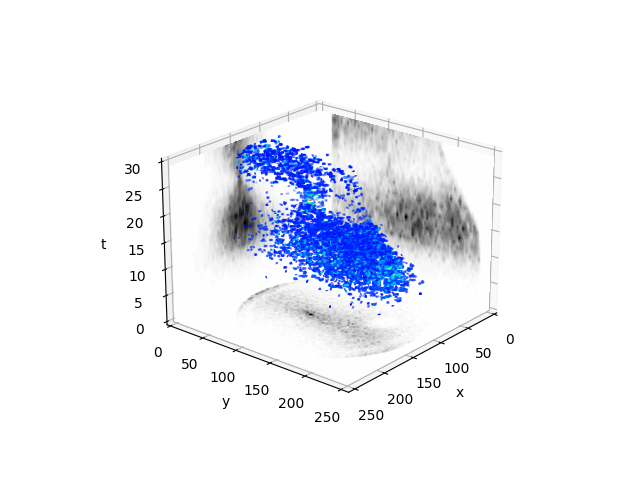

<ipython-input-366-aa6f41692680>:20: UserWarning:

No contour levels were found within the data range.



In [366]:
tmp=np.histogramdd(np.array(circular.drop('batch',axis=1)),bins=(np.linspace(0,255,100),
                                           np.linspace(0,255,100),
                                           np.linspace(4732,4740,31,endpoint=False)))[0]
xx, yy = np.meshgrid(np.linspace(0,255,99,endpoint=False),
                     np.linspace(0,255,99,endpoint=False))
                     

aa , bb =np.meshgrid(np.linspace(0,255,99,endpoint=False),
                     np.linspace(0,30,30,endpoint=False))
    
fig = plt.figure()

ax = plt.axes(projection ='3d')
ax.set_xlim3d(0,255)
ax.set_ylim3d(0,255)

ax.set_zlim3d(0,30)
for i in range(30):
    data=np.ma.masked_where(tmp[:,:,i] <=0, tmp[:,:,i])
    ax.contour(xx, yy, data,50, zdir='z',offset=i,alpha = .2,vmin=0,vmax=8,cmap='jet')

ty_plane = to_plot_2dhist(slow_v,'x','delta_t',
                              bint=np.linspace(4732,4740,31,endpoint=False))
#ty_plane = np.ma.masked_where(ty_plane<=10,ty_plane)

tx_plane = to_plot_2dhist(slow_v,'y','delta_t',
                              bint=np.linspace(4732,4740,31,endpoint=False))
xy_plane =  to_plot_2dhist(slow_v,'x','y',
                              bint=np.linspace(4732,4740,31,endpoint=False))

#tx_plane = np.ma.masked_where(tx_plane<=10,tx_plane)

ax.contourf(aa,tmp.sum(axis=0).T,
            bb,40,offset=0,zdir='y',cmap='Greys')
ax.contourf(tmp.sum(axis=1).T,aa,
            bb,40,offset=0,zdir='x',cmap='Greys')

ax.contourf(xx,yy,tmp.sum(axis=2),40,offset=0,zdir='z',cmap='Greys')

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('t')

#for cutoff in np.linspace(4732,4740,31):
#    tmp= slow_v[(slow_v['delta_t'] >= cutoff) & (slow_v['delta_t'] <= cutoff+0.25)]
#    data = to_plot_2dhist(tmp,'x','y')
#    ax.contour(xx,yy,data ,zdir='z',offset=cutoff)
ax.view_init(azim=40,elev=22)
plt.savefig('3d-circular.pdf')
plt.show()

In [362]:
tmp.max()

12.0

In [244]:
to_plot_2dhist(slow_v,'x','delta_t')

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [210]:
np.repeat(range(20),20).resize((20,20))

In [130]:
fig = plt.figure()
ax = plt.axes()
ax.imshow(np.ma.masked_where(tmp[:,:,10] <= 3, tmp[:,:,10]))
plt.show()

<IPython.core.display.Javascript object>

In [134]:
np.ma.masked_where(tmp[:,:,10] <= 3, tmp[:,:,10])

masked_array(
  data=[[--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --],
        ...,
        [--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --],
        [--, --, --, ..., --, --, --]],
  mask=[[ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        ...,
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True],
        [ True,  True,  True, ...,  True,  True,  True]],
  fill_value=1e+20)

In [63]:
data=go.Volume(
    x=X.flatten(),
    y=Y.flatten(),
    z=Z.flatten(),
    value=values.flatten(),
#    isomin=0.1,
#    isomax=0.8,
    opacity=0.1, # needs to be small to see through all surfaces
    surface_count=17, # needs to be a large number for good volume rendering
    )

In [64]:
data

Volume({
    'opacity': 0.1,
    'surface': {'count': 17},
    'value': array([0., 0., 0., ..., 0., 0., 0.]),
    'x': array([  0.,   0.,   0., ..., 255., 255., 255.]),
    'y': array([  0.,   0.,   0., ..., 255., 255., 255.]),
    'z': array([4732.        , 4732.25806452, 4732.51612903, ..., 4739.48387097,
                4739.74193548, 4740.        ])
})

In [39]:
values.shape

(40, 40, 40)

In [110]:
%matplotlib notebook

# Slowest Horizontal/Vertical

In [18]:
8/0.26

30.769230769230766

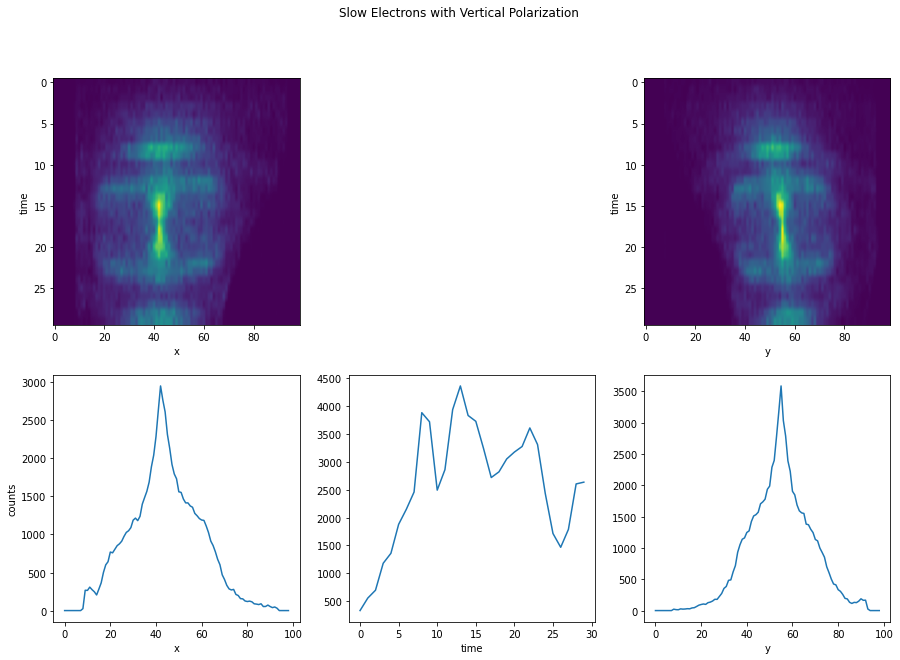

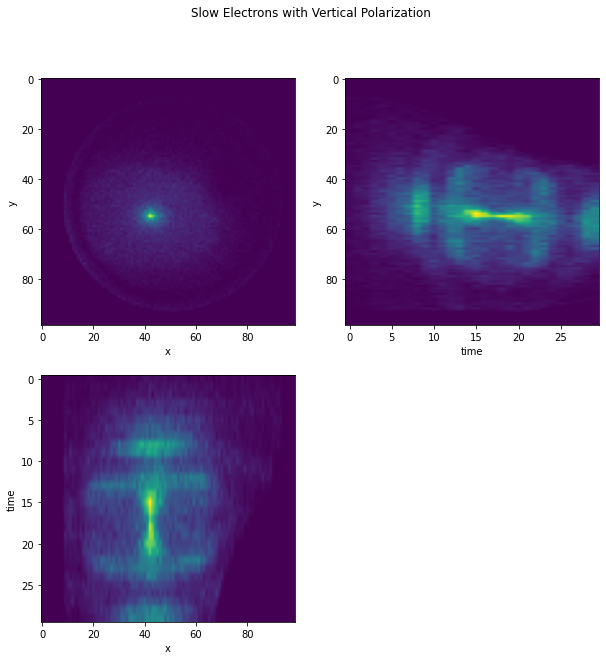

In [19]:
slow_v = pd.read_csv('cent_vert_8.csv')
slow_v.delta_t = slow_v.delta_t*1e9
plot_integrated(slow_v,bint=np.linspace(4732,4740,31,endpoint=False),
                title='Slow Electrons with Vertical Polarization')
plot_projections(slow_v,bint=np.linspace(4732,4740,31,endpoint=False),
                title='Slow Electrons with Vertical Polarization',
                plot_file='vmi_figures/vert-projections.pdf')

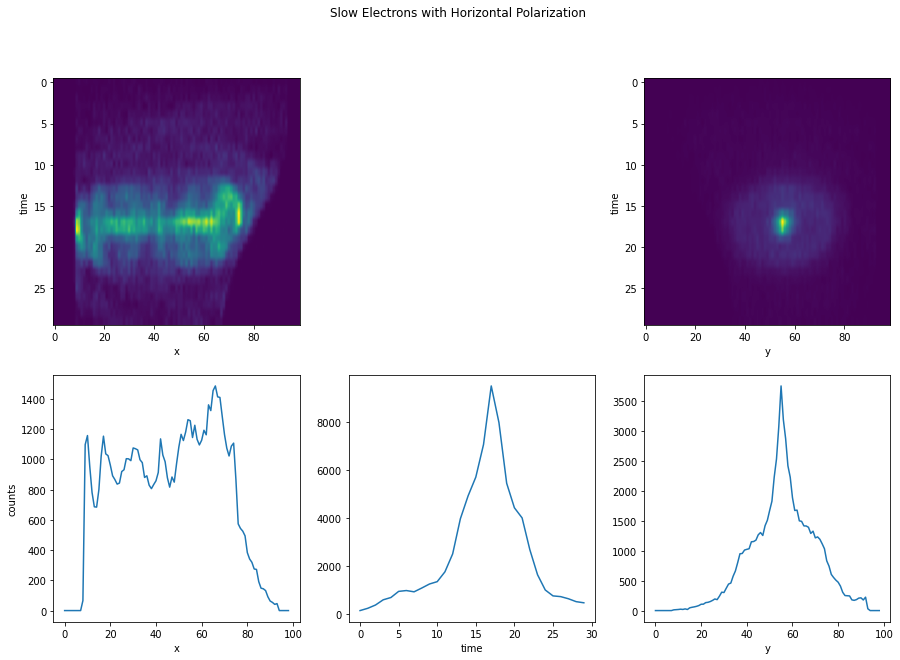

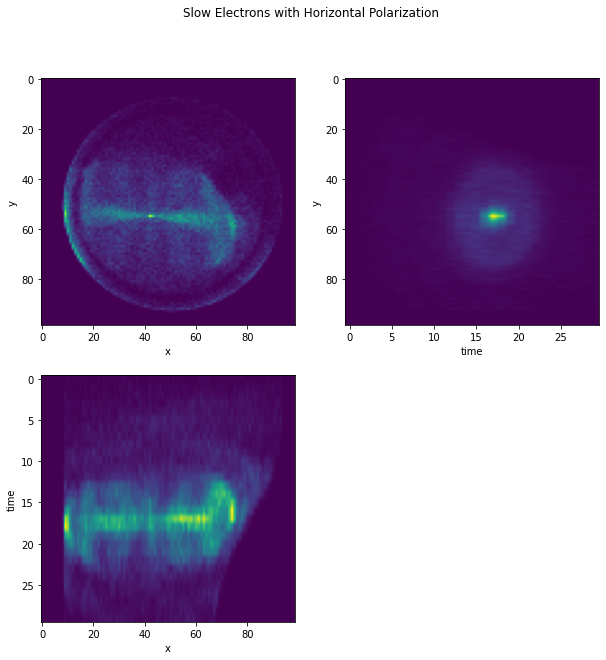

In [20]:
slow_h = pd.read_csv('cent_horiz_7.csv')
slow_h.delta_t = slow_h.delta_t*1e9
plot_integrated(slow_h,bint=np.linspace(4732,4740,31,endpoint=False),
                title='Slow Electrons with Horizontal Polarization')
plot_projections(slow_h,bint=np.linspace(4732,4740,31,endpoint=False),
                title='Slow Electrons with Horizontal Polarization',
                plot_file='vmi_figures/horiz-projections.pdf')

# Medium Speed Electrons Horizontal/Vertical

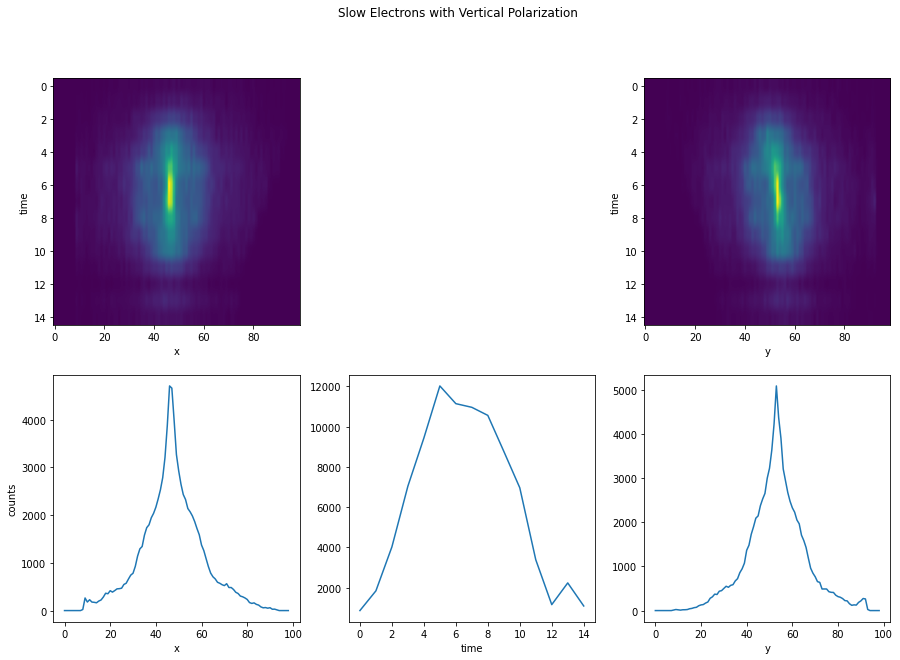

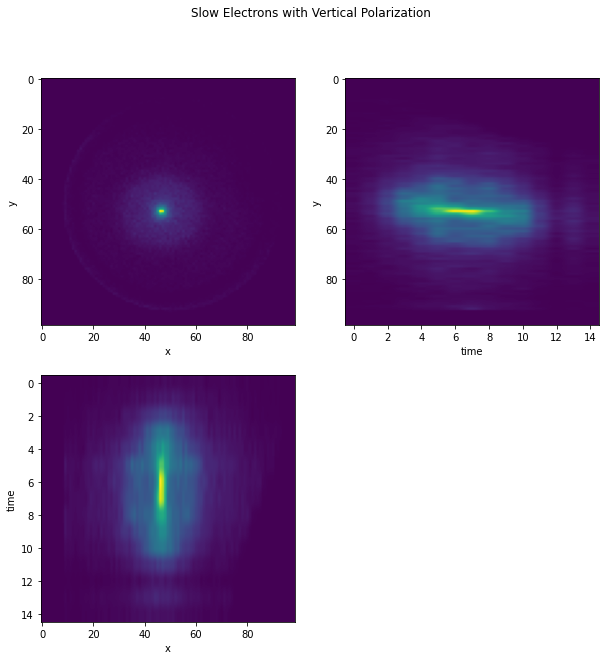

In [21]:
med_v = pd.read_csv('cent_vert_5.csv')
med_v.delta_t = med_v.delta_t*1e9
plot_integrated(med_v,bint=np.linspace(4722,4726,4*4,endpoint=False),
                title='Slow Electrons with Vertical Polarization')
plot_projections(med_v,bint=np.linspace(4722,4726,4*4,endpoint=False),
                title='Slow Electrons with Vertical Polarization')

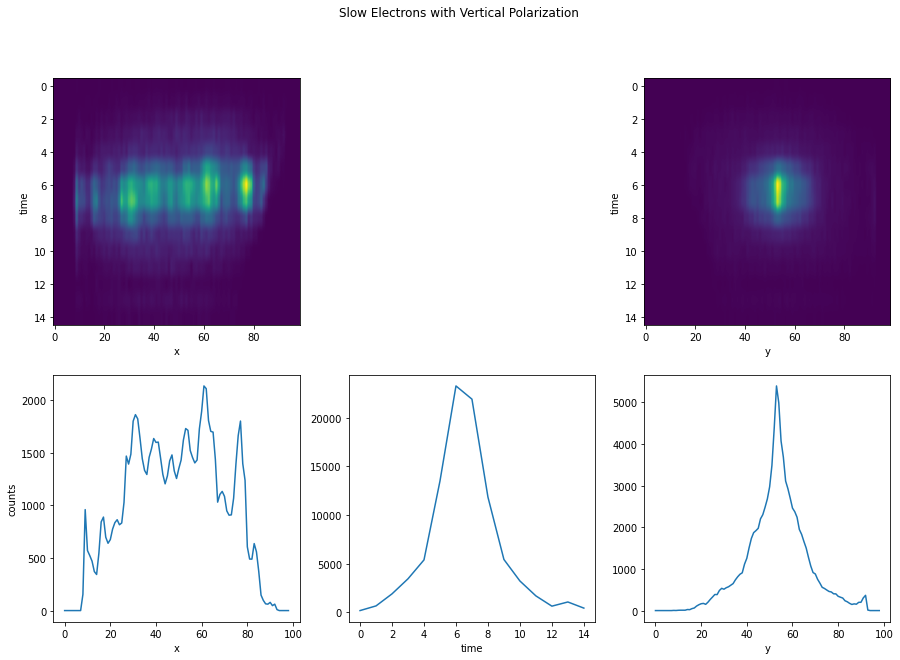

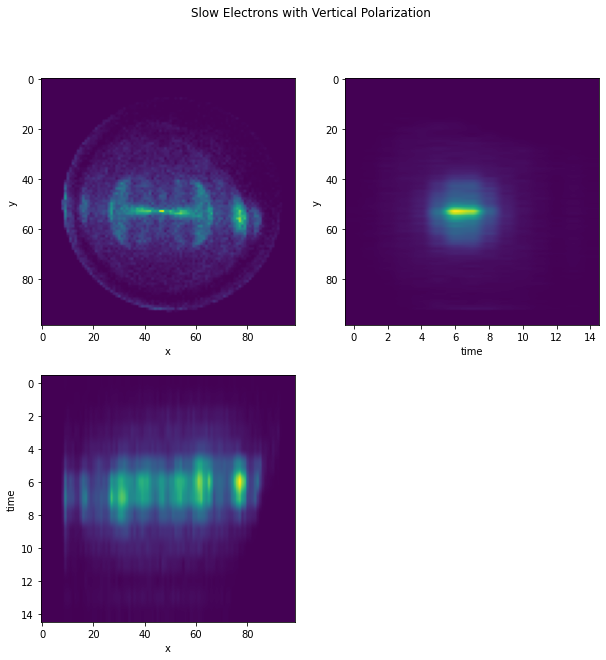

In [22]:
med_h = pd.read_csv('cent_horiz_6.csv')
med_h.delta_t = med_h.delta_t*1e9
plot_integrated(med_h,bint=np.linspace(4722,4726,4*4,endpoint=False),
                title='Slow Electrons with Vertical Polarization')
plot_projections(med_h,bint=np.linspace(4722,4726,4*4,endpoint=False),
                title='Slow Electrons with Vertical Polarization')

# Fast Electrons Horizontal/Vertical

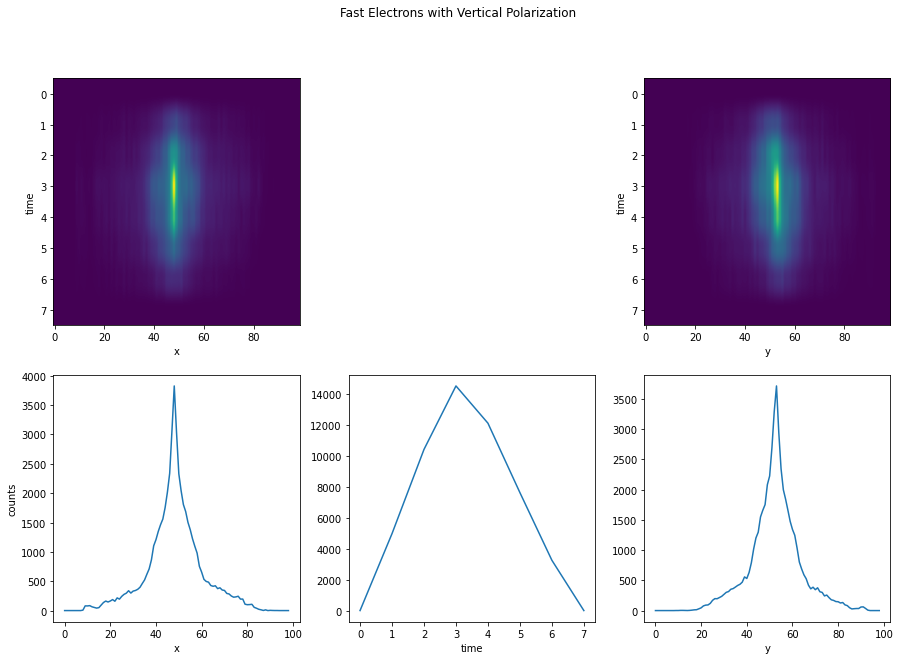

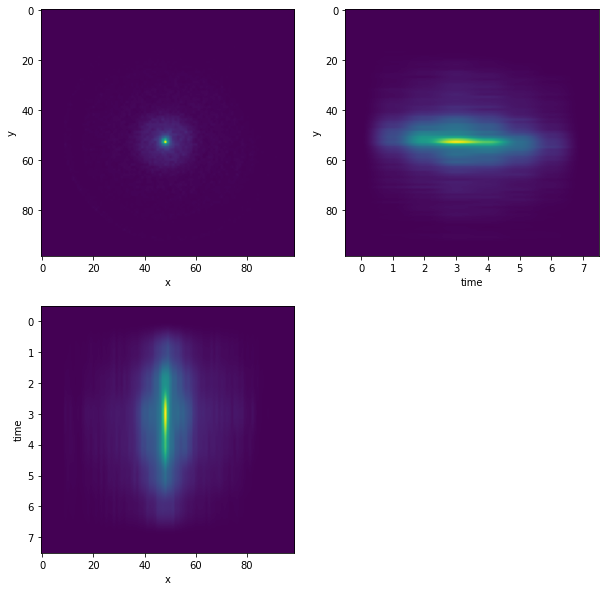

In [23]:
fast_v = pd.read_csv('cent_vert_4.csv')
fast_v.delta_t = fast_v.delta_t*1e9
plot_integrated(fast_v,bint=np.linspace(4718,4720,9,endpoint=False),
                title='Fast Electrons with Vertical Polarization')
plot_projections(fast_v,bint=np.linspace(4718,4720,9,endpoint=False))

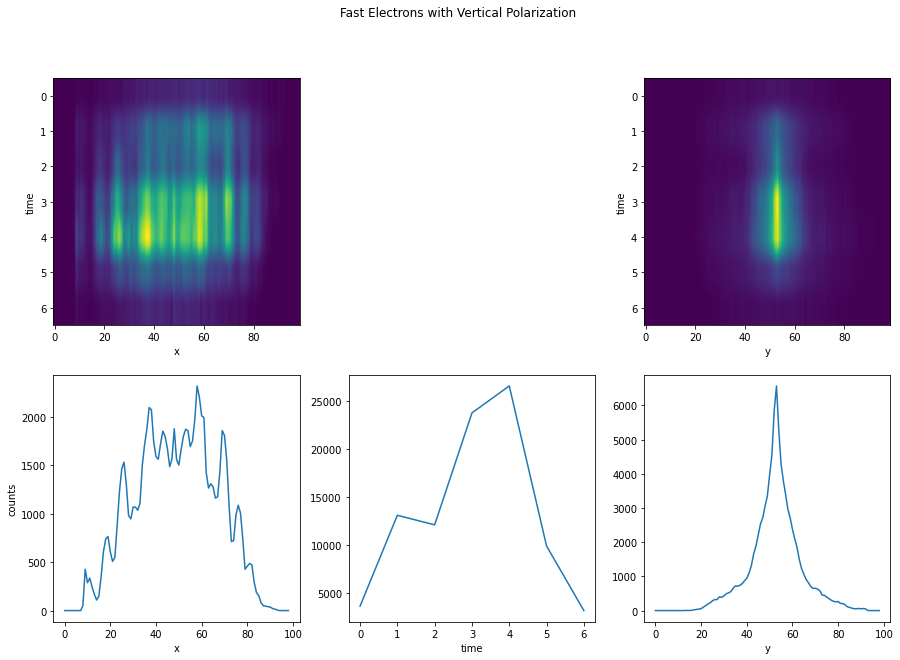

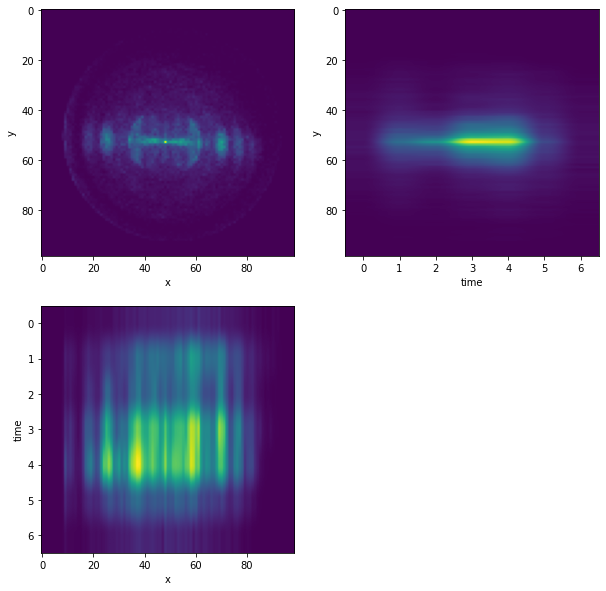

In [24]:
fast_h = pd.read_csv('cent_horiz_3.csv')
fast_h.delta_t = fast_h.delta_t*1e9
plot_integrated(fast_h,bint=np.linspace(4718,4720,8,endpoint=False),
                title='Fast Electrons with Vertical Polarization')
plot_projections(fast_h,bint=np.linspace(4718,4720,8,endpoint=False))

# Comparison of Voltages

In [25]:
2/0.26

7.692307692307692

Text(0, 0.5, 't')

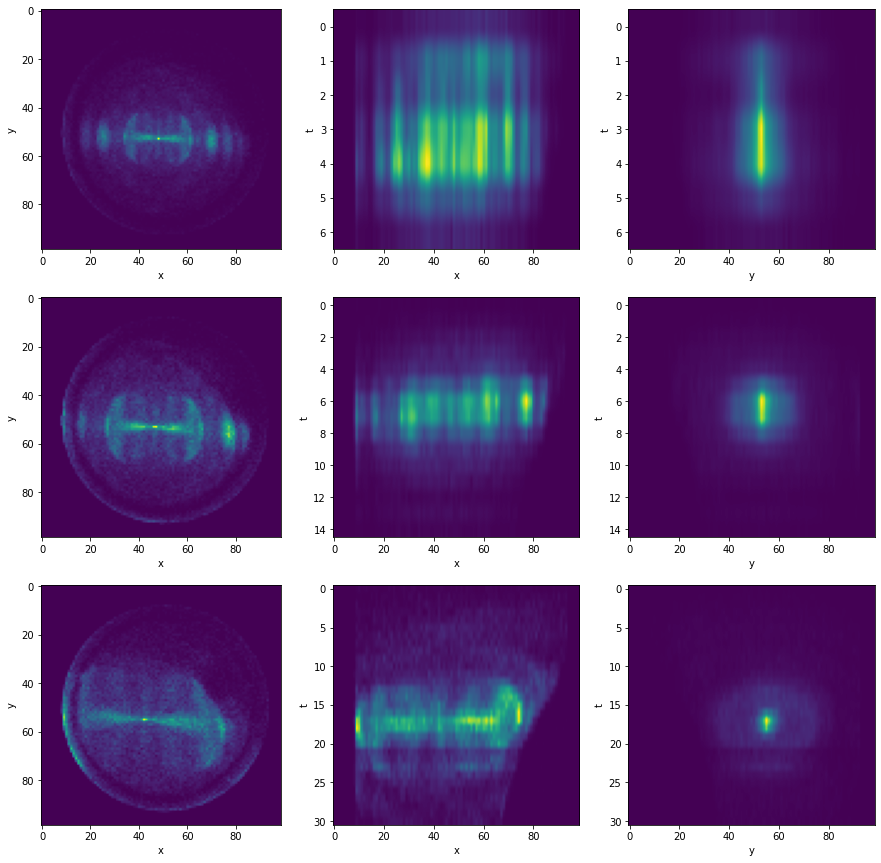

In [26]:
fig = plt.figure(figsize=(15,15))
plt.subplot(331)
plt.imshow(to_plot_2dhist(fast_h,'x','y'))
plt.xlabel('x')
plt.ylabel('y')
plt.subplot(332)
plt.imshow(to_plot_2dhist(fast_h,'x','delta_t',bint=np.linspace(4718,4720,8,endpoint=False)),aspect='auto')
plt.xlabel('x')
plt.ylabel('t')
plt.subplot(333)
plt.imshow(to_plot_2dhist(fast_h,'y','delta_t',bint=np.linspace(4718,4720,8,endpoint=False)),aspect='auto')
plt.xlabel('y')
plt.ylabel('t')
###
plt.subplot(334)
plt.imshow(to_plot_2dhist(med_h,'x','y'))
plt.xlabel('x')
plt.ylabel('y')
plt.subplot(335)
plt.imshow(to_plot_2dhist(med_h,'x','delta_t',bint=np.linspace(4722,4726,4*4,endpoint=False)),aspect='auto')
plt.xlabel('x')
plt.ylabel('t')
plt.subplot(336)
plt.imshow(to_plot_2dhist(med_h,'y','delta_t',bint=np.linspace(4722,4726,4*4,endpoint=False)),aspect='auto')
plt.xlabel('y')
plt.ylabel('t')

###
plt.subplot(337)
plt.imshow(to_plot_2dhist(slow_h,'x','y'))
plt.xlabel('x')
plt.ylabel('y')
plt.subplot(338)
plt.imshow(to_plot_2dhist(slow_h,'x','delta_t',bint=np.linspace(4732,4740,32,endpoint=False)),aspect='auto')
plt.xlabel('x')
plt.ylabel('t')
plt.subplot(339)
plt.imshow(to_plot_2dhist(slow_h,'y','delta_t',bint=np.linspace(4732,4740,32,endpoint=False)),aspect='auto')
plt.xlabel('y')
plt.ylabel('t')

In [27]:
10/0.26

38.46153846153846

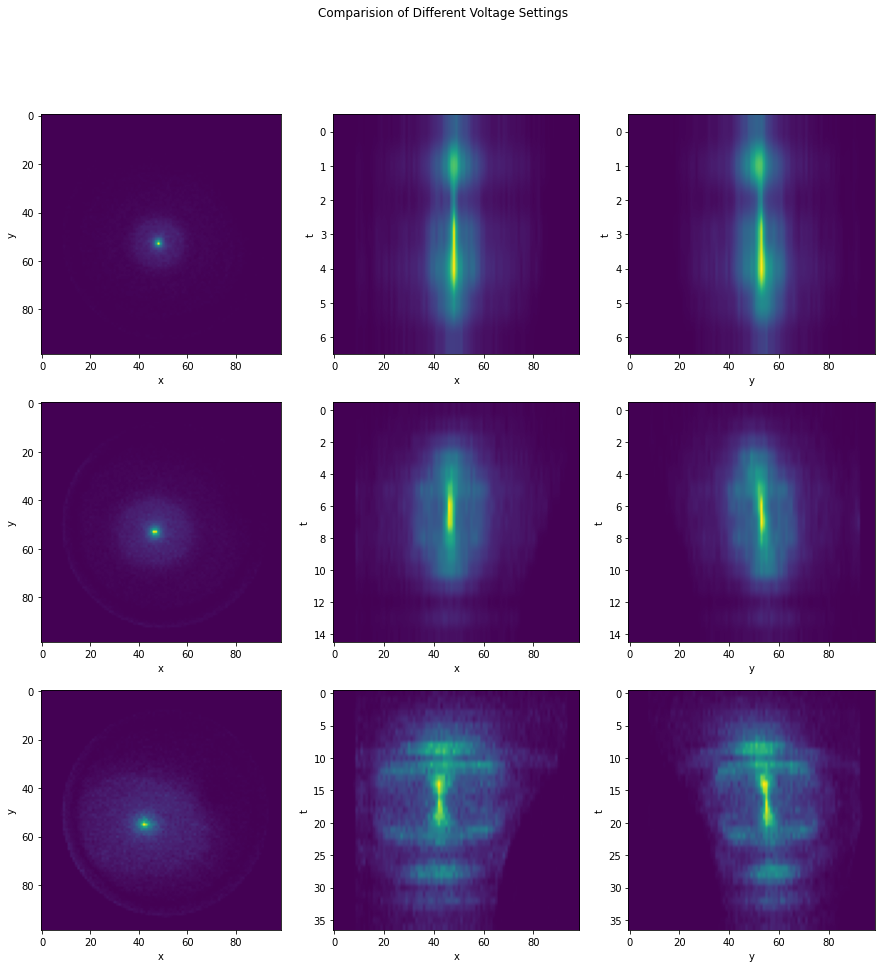

In [28]:
fig = plt.figure(figsize=(15,15))
fig.suptitle('Comparision of Different Voltage Settings')
plt.subplot(331)
plt.imshow(to_plot_2dhist(fast_v,'x','y'))
plt.xlabel('x')
plt.ylabel('y')
plt.subplot(332)
plt.imshow(to_plot_2dhist(fast_v,'x','delta_t',bint=np.linspace(4718,4720,8,endpoint=False)),aspect='auto')
plt.xlabel('x')
plt.ylabel('t')
plt.subplot(333)
plt.imshow(to_plot_2dhist(fast_v,'y','delta_t',bint=np.linspace(4718,4720,8,endpoint=False)),aspect='auto')
plt.xlabel('y')
plt.ylabel('t')
###
plt.subplot(334)
plt.imshow(to_plot_2dhist(med_v,'x','y'))
plt.xlabel('x')
plt.ylabel('y')
plt.subplot(335)
plt.imshow(to_plot_2dhist(med_v,'x','delta_t',bint=np.linspace(4722,4726,4*4,endpoint=False)),aspect='auto')
plt.xlabel('x')
plt.ylabel('t')
plt.subplot(336)
plt.imshow(
    to_plot_2dhist(med_v,'y','delta_t',bint=np.linspace(4722,4726,4*4,endpoint=False))
           ,aspect='auto')
plt.xlabel('y')
plt.ylabel('t')

###
plt.subplot(337)
plt.imshow(to_plot_2dhist(slow_v,'x','y'))
plt.xlabel('x')
plt.ylabel('y')
plt.subplot(338)
plt.imshow(to_plot_2dhist(slow_v,'x','delta_t',bint=np.linspace(4732,4742,38,endpoint=False))
           ,aspect='auto')
plt.xlabel('x')
plt.ylabel('t')
plt.subplot(339)
plt.imshow(
    to_plot_2dhist(slow_v,'y','delta_t',bint=np.linspace(4732,4742,38,endpoint=False)),aspect='auto')
plt.xlabel('y')
plt.ylabel('t')
plt.savefig('vmi_figures/voltage-comparisions')

# Circular Polarization

In [29]:
15/0.26

57.69230769230769

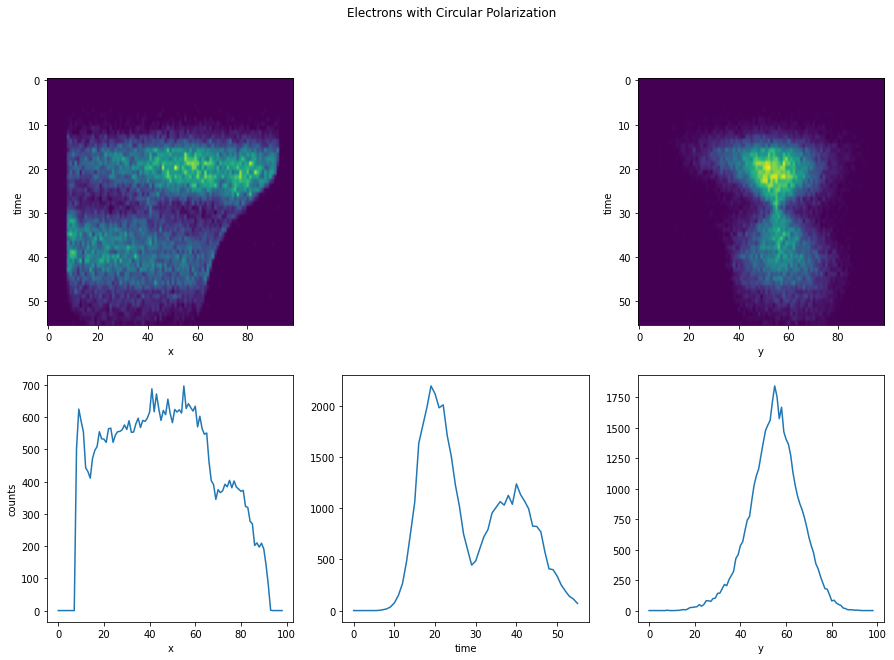

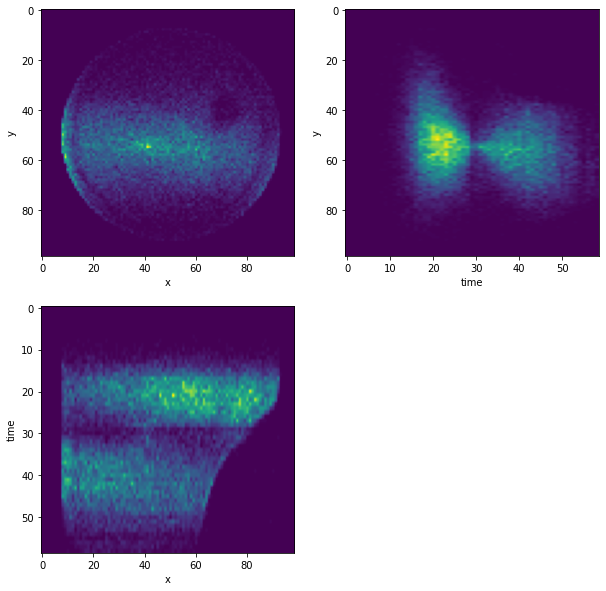

In [30]:
circular = pd.read_csv('cent_45deg_11.csv')
circular.delta_t = circular.delta_t*1e9
plot_integrated(circular,bint=np.linspace(4730,4745,57,endpoint=False),
                title='Electrons with Circular Polarization')
plot_projections(circular,bint=np.linspace(4730,4745,15*4,endpoint=False))

# Elliptical Polarization

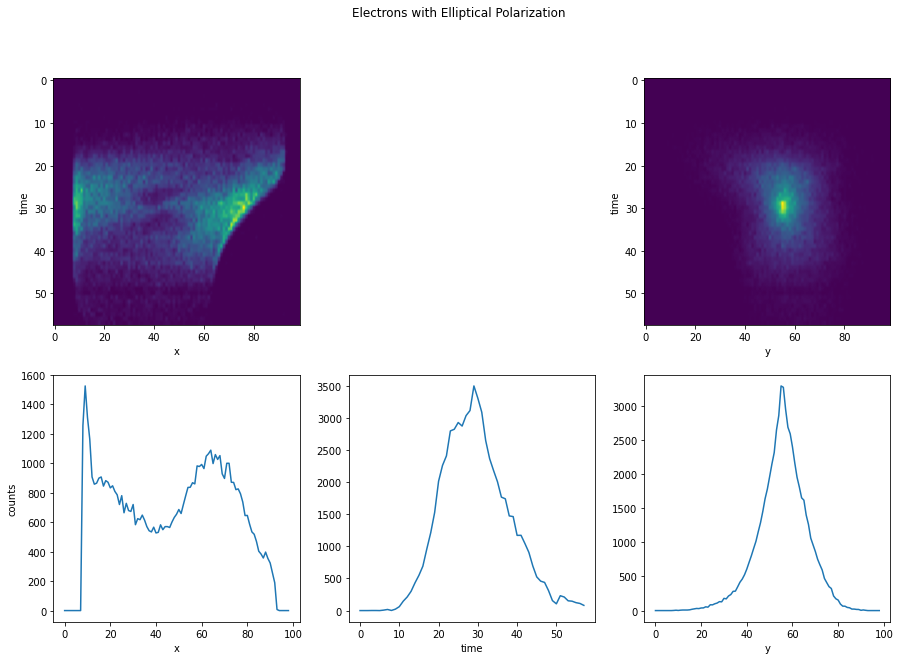

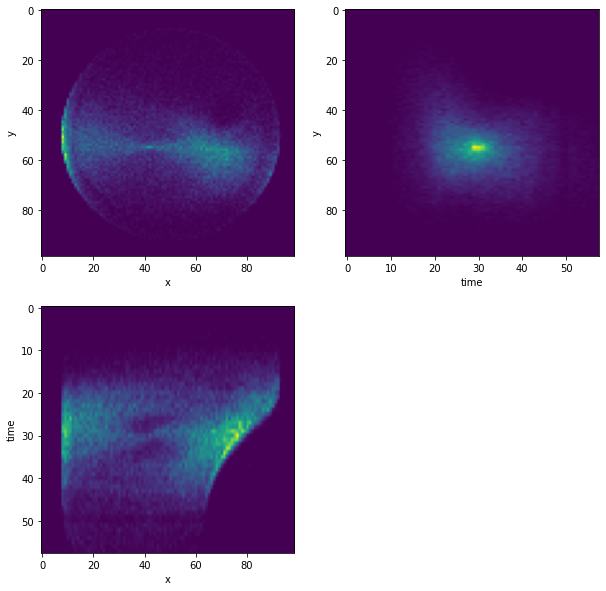

In [31]:
ellip = pd.read_csv('cent_30deg_12.csv')
ellip.delta_t = ellip.delta_t*1e9
plot_integrated(ellip,bint=np.linspace(4730,4745,59,endpoint=False),
                title='Electrons with Elliptical Polarization')
plot_projections(ellip,bint=np.linspace(4730,4745,59,endpoint=False))

# Figures for the Paper

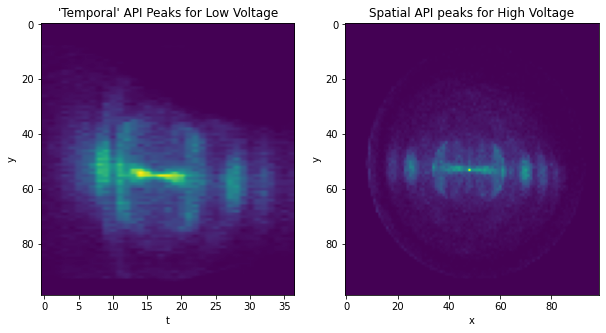

In [32]:
fig = plt.figure(figsize=(10,5))
plt.subplot(121)
plt.imshow(to_plot_2dhist(slow_v,'delta_t','y',bint=np.linspace(4732,4742,38,endpoint=False)),aspect='auto')
plt.xlabel('t')
plt.ylabel('y')
plt.title('\'Temporal\' API Peaks for Low Voltage')
plt.subplot(122)
plt.title('Spatial API peaks for High Voltage')
plt.imshow(to_plot_2dhist(fast_h,'x','y',bint=np.linspace(4718,4720,8,endpoint=False)),aspect='auto')
plt.xlabel('x')
plt.ylabel('y')
plt.savefig('vmi_figures/temporal-vs-spatial.pdf')

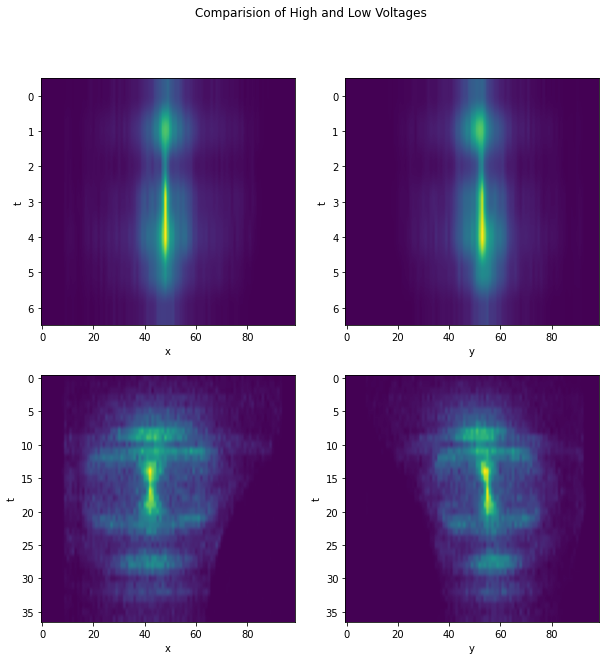

In [31]:
fig = plt.figure(figsize=(10,10))
fig.suptitle('Comparision of High and Low Voltages')
plt.subplot(221)
plt.imshow(to_plot_2dhist(fast_v,'x','delta_t',bint=np.linspace(4718,4720,8,endpoint=False)),aspect='auto')
plt.xlabel('x')
plt.ylabel('t')
plt.subplot(222)
plt.imshow(to_plot_2dhist(fast_v,'y','delta_t',bint=np.linspace(4718,4720,8,endpoint=False)),aspect='auto')
plt.xlabel('y')
plt.ylabel('t')


###

plt.subplot(223)
plt.imshow(to_plot_2dhist(slow_v,'x','delta_t',bint=np.linspace(4732,4742,38,endpoint=False))
           ,aspect='auto')
plt.xlabel('x')
plt.ylabel('t')
plt.subplot(224)
plt.imshow(
    to_plot_2dhist(slow_v,'y','delta_t',bint=np.linspace(4732,4742,38,endpoint=False)),aspect='auto')
plt.xlabel('y')
plt.ylabel('t')
plt.savefig('vmi_figures/high-vs-low.pdf')

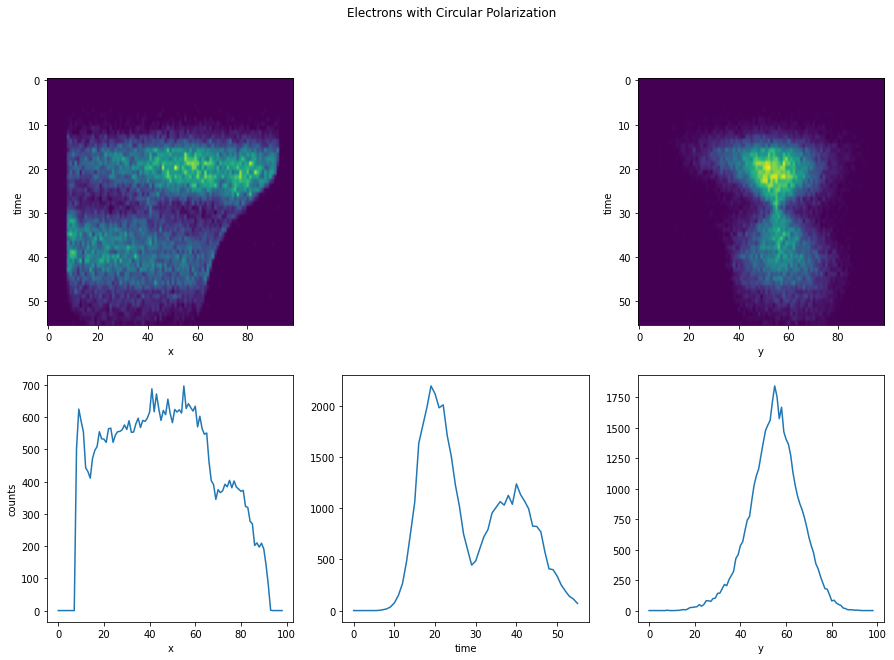

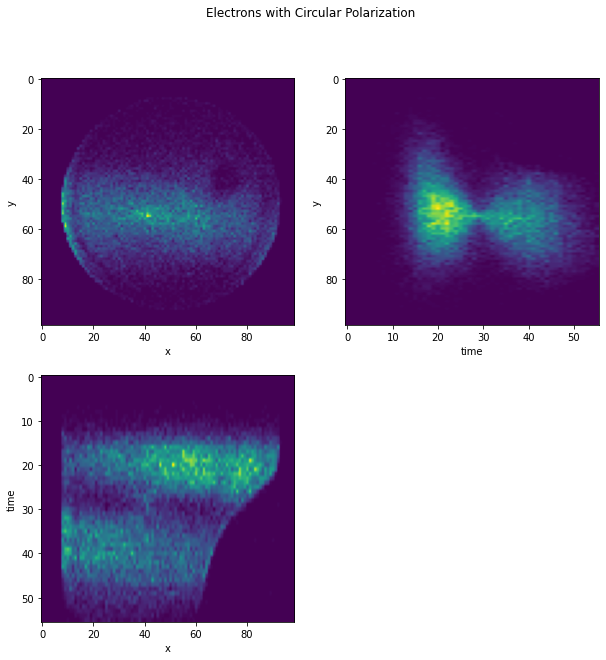

In [42]:
plot_integrated(circular,bint=np.linspace(4730,4745,57,endpoint=False),
                title='Electrons with Circular Polarization',
               plot_file = 'vmi_figures/circular-integrated.pdf')
plot_projections(circular,bint=np.linspace(4730,4745,57,endpoint=False),
                title='Electrons with Circular Polarization',
               plot_file = 'vmi_figures/circular-projections.pdf')

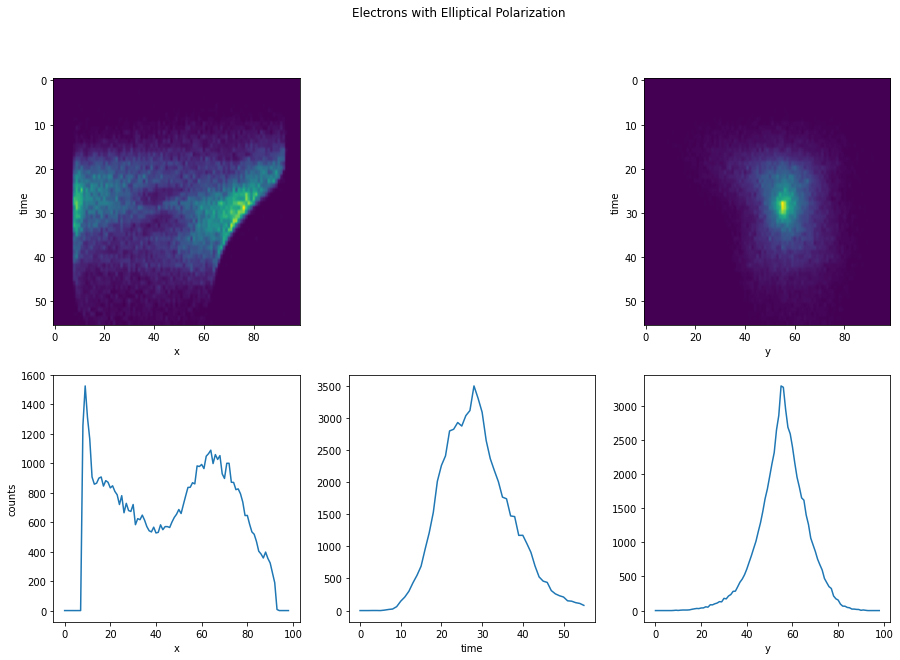

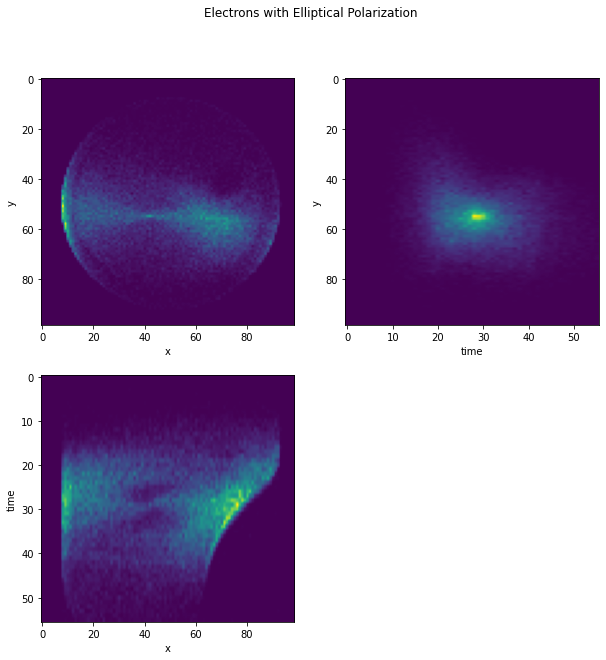

In [41]:
plot_integrated(ellip,bint=np.linspace(4730,4745,57,endpoint=False),
                title='Electrons with Elliptical Polarization',
               plot_file='vmi_figures/ellip-integrated.pdf')
plot_projections(ellip,bint=np.linspace(4730,4745,57,endpoint=False),
                 title='Electrons with Elliptical Polarization',
                plot_file='vmi_figures/ellip-projections.pdf')